### Installation

In [2]:
!pip install -q accelerate datasets peft bitsandbytes

### Get model

In [1]:
import wandb

with open("/home/cchang/wandb.key", "r") as f:
    wandb_key = f.read().strip()
    
wandb.login(key=wandb_key)
wandb.init(
    project="DriveLM",
)

wandb: Currently logged in as: changchuntzu (jessica-chang). Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /home/cchang/.netrc


In [3]:
import torch
from peft import LoraConfig
from transformers import AutoProcessor, BitsAndBytesConfig, Idefics2ForConditionalGeneration
from transformers.image_utils import load_image
import json
import matplotlib.pyplot as plt
from PIL import Image
from typing import Dict
from tqdm import tqdm
import copy

DEVICE = "cuda:0"
USE_LORA = False
USE_QLORA = True

In [4]:
IMAGE_DIR = '/home/cchang/CS503_VisualIntelligence/data/nuscenes/samples'
IMAGE_PATH_PREFIX = '../nuscenes/samples'
IMAGE_SRC_X, IMAGE_SRC_Y = 1600, 900
IMAGE_TGT_X, IMAGE_TGT_Y = int(IMAGE_SRC_X / 2.5), int(IMAGE_SRC_Y / 2.5)

train_data_path = '/home/cchang/CS503_VisualIntelligence/thinking-fast-and-furious/baseline/experiments/eea/data/nuscenes/v1_1_train_nus_ext.json'
test_data_path = '/home/cchang/CS503_VisualIntelligence/thinking-fast-and-furious/drivelm/challenge/test_eval.json'
idefics_train_data_path = '/home/cchang/CS503_VisualIntelligence/thinking-fast-and-furious/baseline/experiments/eea/data/nuscenes/train_v1_ext_idefics_redcircle.json'
idefics_test_data_path = '/home/cchang/CS503_VisualIntelligence/thinking-fast-and-furious/baseline/experiments/eea/data/nuscenes/test_ext_idefics_redcircle.json'
zero_shot_predictions_path = "/home/cchang/CS503_VisualIntelligence/thinking-fast-and-furious/baseline/experiments/eea/outputs/test-eval-idefics2-8b-zero-shot_redcirecle.json"
checkpoint_dir = "/home/cchang/CS503_VisualIntelligence/thinking-fast-and-furious/baseline/experiments/eea/models/idefics_redcircle"

In [5]:
processor = AutoProcessor.from_pretrained(
    "HuggingFaceM4/idefics2-8b",
    do_image_splitting=False
)


# Three options for training, from the lowest precision training to the highest precision training:
# - QLora
# - Standard Lora
# - Full fine-tuning
if USE_QLORA or USE_LORA:
    lora_config = LoraConfig(
        r=8,
        lora_alpha=8,
        lora_dropout=0.1,
        target_modules='.*(text_model|modality_projection|perceiver_resampler).*(down_proj|gate_proj|up_proj|k_proj|q_proj|v_proj|o_proj).*$',
        use_dora=False if USE_QLORA else True,
        init_lora_weights="gaussian"
    )
    if USE_QLORA:
        bnb_config = BitsAndBytesConfig(
            load_in_4bit=True,
            bnb_4bit_quant_type="nf4",
            bnb_4bit_compute_dtype=torch.float16
        )
    model = Idefics2ForConditionalGeneration.from_pretrained(
        "HuggingFaceM4/idefics2-8b",
        torch_dtype=torch.float16,
        quantization_config=bnb_config if USE_QLORA else None,
    )
    model.add_adapter(lora_config)
    model.enable_adapters()
else:
    model = Idefics2ForConditionalGeneration.from_pretrained(
        "HuggingFaceM4/idefics2-8b",
        torch_dtype=torch.float16,
        _attn_implementation="flash_attention_2", # Only available on A100 or H100
    ).to(DEVICE)



/home/cchang/miniconda3/envs/cs503vi/lib/python3.8/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.
`low_cpu_mem_usage` was None, now set to True since model is quantized.


Loading checkpoint shards:   0%|          | 0/7 [00:00<?, ?it/s]

In [6]:
def vizualize_frames(image_paths):
    y_view_mapping = {"MIDDLE": 1, "LEFT": 0, "RIGHT": 2}
    fig, axes = plt.subplots(2, 3, figsize=(48, 18))
    for i, (image_view, image_path) in enumerate(image_paths.items()):
        image = Image.open(image_path)
        _, x, y = f"{image_view}_MIDDLE".split("_")[:3]
        x_id = int(x == 'BACK')
        axes[x_id][y_view_mapping[y]].imshow(image)
        axes[x_id][y_view_mapping[y]].set_title(image_view)
        axes[x_id][y_view_mapping[y]].axis('off')
    plt.show()
    
def process_scene(scene_id, scene):
    samples = []
    for frame_id, frame in scene['key_frames'].items():
        image_paths = {view_name: view_path.replace(IMAGE_PATH_PREFIX, IMAGE_DIR) for view_name, view_path in frame['image_paths'].items()}
        assert len(image_paths) == 6, "not all views provided"
        question_id = 0
        for question_type, questions in frame['QA'].items():
            for question_info in questions:
                question = question_info['Q']
                answer = question_info['A'] if "A" in question_info else ""
                sample_id = f"{scene_id}_{frame_id}_{question_id}"
                question_id += 1
                samples.append({
                    "sample_id": sample_id,
                    "question_type": question_type,
                    "question_text": question,
                    "images": image_paths,
                    "answer": answer
                })
    return samples


def process_dataset(data_path, output_path=None):
    with open(data_path, "r") as f:
        dataset: Dict[str, str] = json.load(f)
    samples = []
    for scene_id, scene in tqdm(dataset.items()):
        samples.extend(process_scene(scene_id, scene))
    if output_path:
        with open(output_path, "w") as f:
            json.dump(samples, f)
    return samples


def convert_sample_to_idefics(sample):
    idefics_sample = copy.deepcopy(sample)
    question = sample["question_text"]
    user_message = [
        {
            "role": "user",
            "content": [
                {"type": "image", "text": "CAM_BACK"},
                {"type": "image", "text": "CAM_BACK_LEFT"},
                {"type": "image", "text": "CAM_BACK_RIGHT"},
                {"type": "image", "text": "CAM_FRONT"},
                {"type": "image", "text": "CAM_FRONT_LEFT"},
                {"type": "image", "text": "CAM_FRONT_RIGHT"},
                {"type": "text", "text": question},
            ]
        }
    ]
    idefics_sample["user_message"] = user_message
    return idefics_sample


def produce_idefics_dataset(samples, output_path=None):
    idefics_samples = []
    for sample in samples:
        idefics_samples.append(convert_sample_to_idefics(sample))
    if output_path:
        with open(output_path, "w") as f:
            json.dump(idefics_samples, f)
            
    return idefics_samples

In [ ]:
def draw_red_circle(image_path):
    image = PIL.Image.open(image_path)
    image = PIL.ImageOps.exif_transpose(image)
    image = image.convert("RGB")
    

In [7]:
def eval_model(model, test_set, verbose=False):
    predictions = []
    for idefics_sample in tqdm(test_set):
        image_paths = idefics_sample['images']
        images = [load_image(image_path).resize((IMAGE_TGT_X, IMAGE_TGT_Y)) for image_path in image_paths.values()]
        if verbose:
            vizualize_frames(image_paths)
    
        prompt = processor.apply_chat_template(idefics_sample['user_message'], add_generation_prompt=True)
        inputs = processor(text=prompt, images=images, return_tensors="pt")
        inputs = {k: v.to(DEVICE) for k, v in inputs.items()}
    
        # Generate
        generated_ids = model.generate(**inputs, max_new_tokens=500)
        generated_texts = processor.batch_decode(generated_ids, skip_special_tokens=True)
    
        predicted_text = generated_texts[0].split('\n')[-1][len("Assistant: "):]
        prediction = copy.deepcopy(idefics_sample)
        prediction['gt'] = prediction['answer']
        prediction['answer'] = predicted_text
        predictions.append(prediction)
        if verbose:
            print(idefics_sample['question_text'])
            print('Predicted:', predicted_text)
            print('GT:', prediction['gt'])
    return predictions
        

In [8]:
train_dataset = process_dataset(train_data_path)
test_dataset = process_dataset(test_data_path)

train_idefics_dataset = produce_idefics_dataset(train_dataset, output_path=idefics_train_data_path)
test_idefics_dataset = produce_idefics_dataset(test_dataset, output_path=idefics_test_data_path)

100%|████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 8413.85it/s]


In [20]:
len(zero_shot_predictions)

10

### Zero-shot inference

  0%|                                                                         | 0/10 [00:00<?, ?it/s]

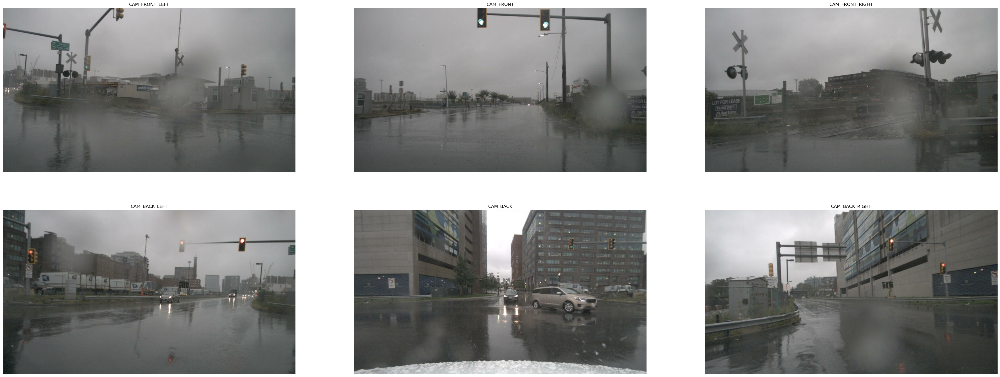


No chat template is defined for this tokenizer - using the default template for the LlamaTokenizerFast class. If the default is not appropriate for your model, please set `tokenizer.chat_template` to an appropriate template. See https://huggingface.co/docs/transformers/main/chat_templating for more information.

The `seen_tokens` attribute is deprecated and will be removed in v4.41. Use the `cache_position` model input instead.
 10%|██████▌                                                          | 1/10 [00:05<00:53,  5.99s/it]

What are the important objects in the current scene? Those objects will be considered for the future reasoning and driving decision.
Predicted: Traffic lights.
GT: There is a brown SUV to the back of the ego vehicle, a black sedan to the back of the ego vehicle, and a green light to the front of the ego vehicle. The IDs of these objects are <c1,CAM_BACK,1088.3,497.5>, <c2,CAM_BACK,864.2,468.3>, and <c3,CAM_FRONT,1043.2,82.2>.


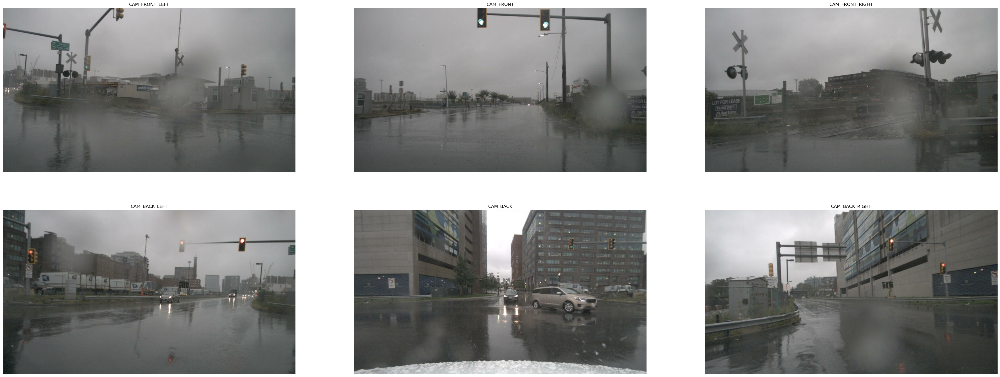

 20%|█████████████                                                    | 2/10 [00:09<00:36,  4.52s/it]

What is the moving status of object <c1,CAM_BACK,1088.3,497.5>? Please select the correct answer from the following options: A. Going ahead. B. Stopped. C. Back up. D. Turn left.
Predicted: B. Stopped.
GT: D


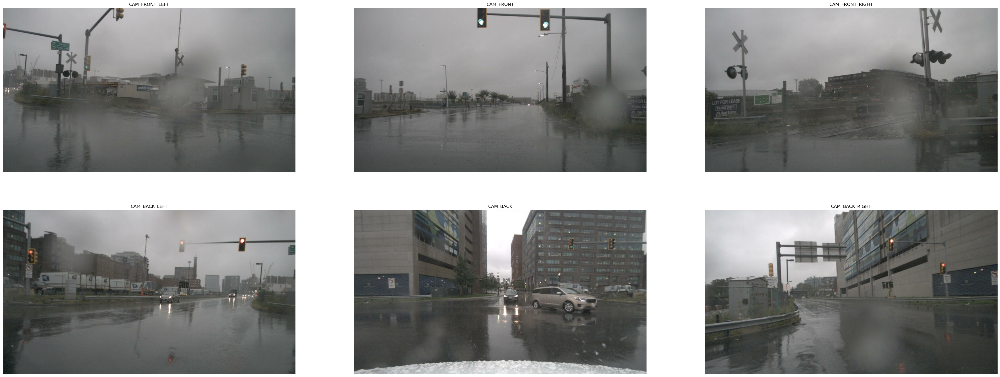

 30%|███████████████████▌                                             | 3/10 [00:17<00:42,  6.08s/it]

What object should the ego vehicle notice first when the ego vehicle is getting to the next possible location? What is the state of the object that is first noticed by the ego vehicle and what action should the ego vehicle take? What object should the ego vehicle notice second when the ego vehicle is getting to the next possible location? What is the state of the object perceived by the ego vehicle as second and what action should the ego vehicle take? What object should the ego vehicle notice third? What is the state of the object perceived by the ego vehicle as third and what action should the ego vehicle take?
Predicted: The first object the ego vehicle should notice is a stop sign. The ego vehicle should stop at the stop sign. The second object the ego vehicle should notice is a traffic light. The traffic light should be red. The third object the ego vehicle should notice is a pedestrian. The pedestrian should be crossing the road.
GT: Firstly notice that <c3,CAM_FRONT,1043.2,82.2>

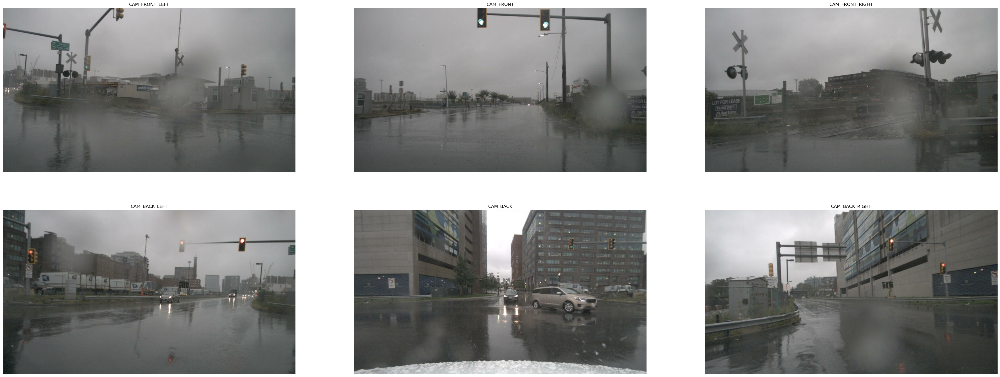

 40%|██████████████████████████                                       | 4/10 [00:20<00:30,  5.02s/it]

Is <c1,CAM_BACK,1088.3,497.5> a traffic sign or a road barrier?
Predicted: Traffic sign.
GT: No.


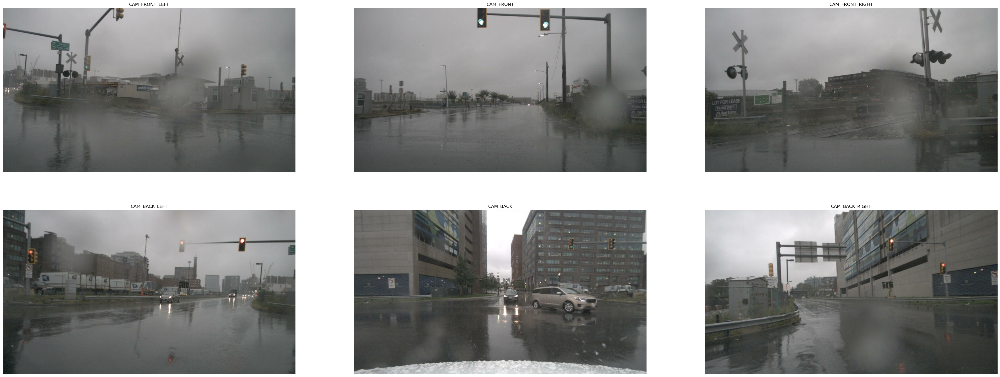

 50%|████████████████████████████████▌                                | 5/10 [00:28<00:29,  5.85s/it]

What actions could the ego vehicle take based on <c1,CAM_BACK,1088.3,497.5>? Why take this action and what's the probability?
Predicted: The action of turning left could be taken based on <c1,CAM_BACK,1088.3,497.5>. The probability of this action is high because the vehicle is currently traveling straight and the left turn would put it on the correct path.
GT: The action is to keep going at the same speed. The reason is to follow the traffic rules, which has a high probability.


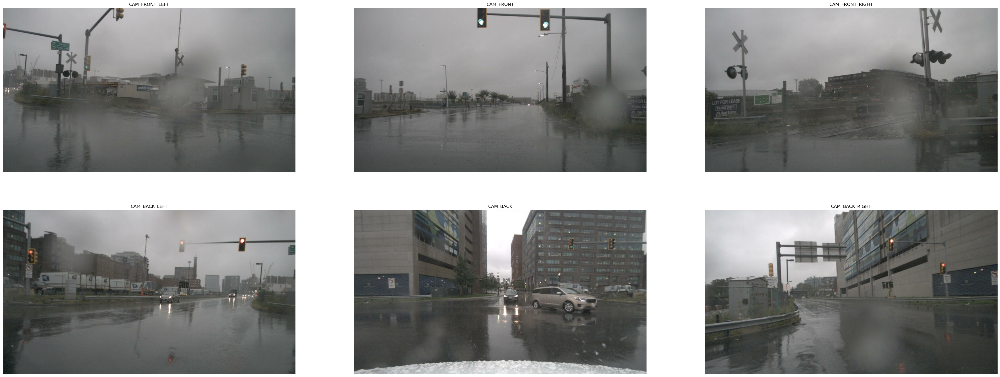

 60%|███████████████████████████████████████                          | 6/10 [00:34<00:23,  5.94s/it]

What actions taken by the ego vehicle can lead to a collision with <c1,CAM_BACK,1088.3,497.5>?
Predicted: If the ego vehicle is moving too fast or is not paying attention, it could collide with <c1,CAM_BACK,1088.3,497.5>.
GT: No such action will lead to a collision.


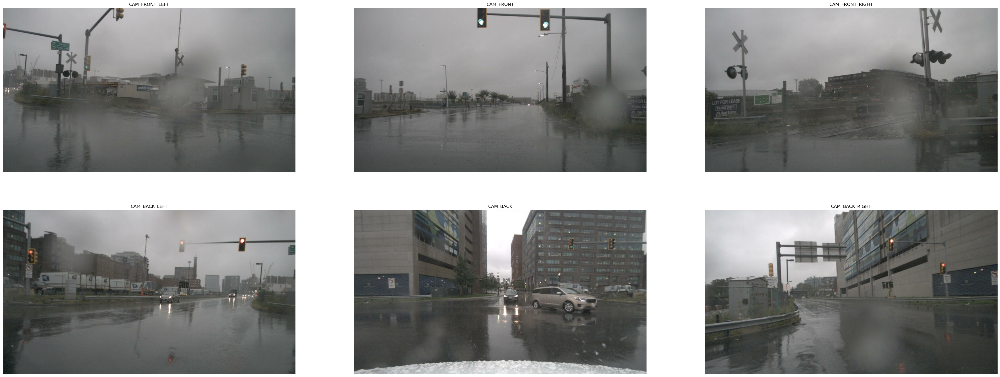

 70%|█████████████████████████████████████████████▌                   | 7/10 [00:38<00:15,  5.29s/it]

In this scenario, what are safe actions to take for the ego vehicle?
Predicted: The ego vehicle should slow down and approach the stop sign.
GT: Keep going at the same speed, decelerate gradually without braking.


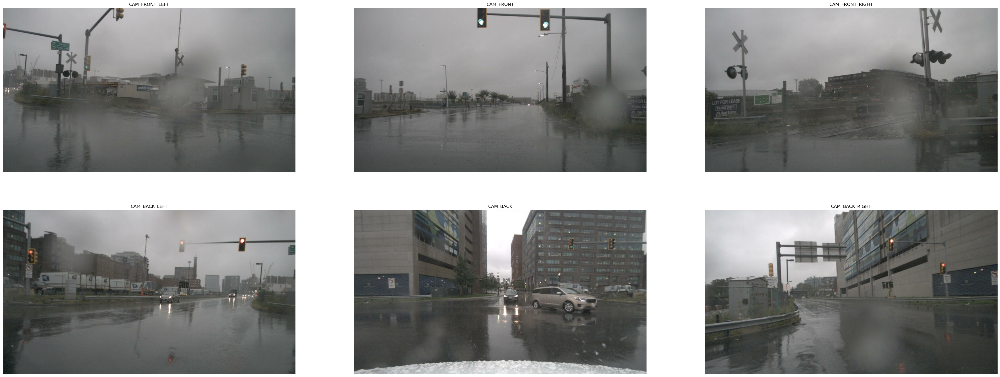

 80%|████████████████████████████████████████████████████             | 8/10 [00:42<00:10,  5.11s/it]

Predict the behavior of the ego vehicle. Please select the correct answer from the following options: A. The ego vehicle is slightly steering to the left. The ego vehicle is driving fast. B. The ego vehicle is going straight. The ego vehicle is driving fast. C. The ego vehicle is slightly steering to the left. The ego vehicle is driving with normal speed. D. The ego vehicle is going straight. The ego vehicle is driving with normal speed.
Predicted: D. The ego vehicle is going straight. The ego vehicle is driving with normal speed.
GT: B


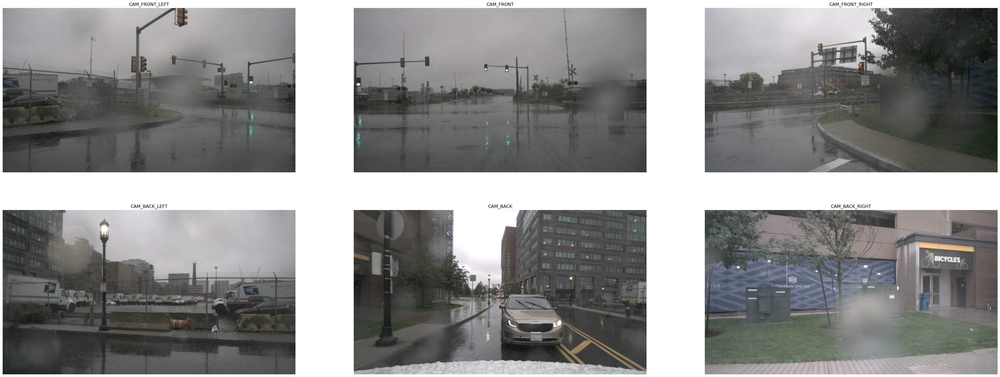

 90%|██████████████████████████████████████████████████████████▌      | 9/10 [00:47<00:05,  5.05s/it]

What are the important objects in the current scene? Those objects will be considered for the future reasoning and driving decision.
Predicted: Light post, traffic lights, signs, buildings, cars, puddles, mail trucks, mailboxes.
GT: There is a champagne-colored sedan to the back of the ego vehicle, a green light to the front of the ego vehicle, and a red light to the front left of the ego vehicle. The IDs of these objects are <c1,CAM_BACK,991.7,603.0>, <c2,CAM_FRONT,836.3,398.3>, and <c3,CAM_FRONT_LEFT,1075.5,382.8>.


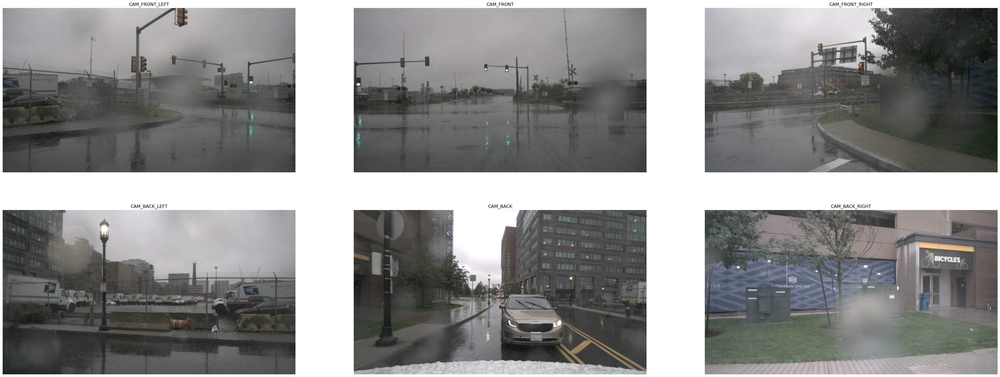

100%|████████████████████████████████████████████████████████████████| 10/10 [00:56<00:00,  5.64s/it]


What object should the ego vehicle notice first when the ego vehicle is getting to the next possible location? What is the state of the object that is first noticed by the ego vehicle and what action should the ego vehicle take? What object should the ego vehicle notice second when the ego vehicle is getting to the next possible location? What is the state of the object perceived by the ego vehicle as second and what action should the ego vehicle take? What object should the ego vehicle notice third? What is the state of the object perceived by the ego vehicle as third and what action should the ego vehicle take?
Predicted: The first object the ego vehicle should notice is the stop sign. The ego vehicle should stop at the stop sign. The second object the ego vehicle should notice is the traffic lights. The traffic lights should be green. The third object the ego vehicle should notice is the street sign. The street sign should indicate that the ego vehicle is in the correct lane.
GT: Fi

100%|████████████████████████████████████████████████████████████████| 66/66 [02:33<00:00,  2.33s/it]


In [9]:
_ = eval_model(model, test_idefics_dataset[:10], verbose=True)

zero_shot_predictions = eval_model(model, test_idefics_dataset)
with open(zero_shot_predictions_path, "w") as f:
     json.dump(zero_shot_predictions, f, indent=4)

### Fine-tuning

In [23]:
from datasets import load_dataset

data = load_dataset('json', data_files=idefics_train_data_path, split=None)
split_dataset = data['train'].train_test_split(test_size=0.025)

Generating train split: 0 examples [00:00, ? examples/s]

In [24]:
class GVQADataCollator:
    def __init__(self, processor):
        self.processor = processor
        self.image_token_id = processor.tokenizer.additional_special_tokens_ids[
            processor.tokenizer.additional_special_tokens.index("<image>")
        ]

    def __call__(self, examples):
        texts = []
        images = []
        for example in examples:
            sample_images = [load_image(image_path).resize((IMAGE_TGT_X, IMAGE_TGT_Y)) for image_path in example['images'].values()]
            answer_text = example["answer"]
            answer_message = {
                    "role": "assistant",
                    "content": [
                        {"type": "text", "text": answer_text}
                    ]
            }
            user_message = example['user_message'][0]
            messages = [user_message, answer_message]
            text = self.processor.apply_chat_template(messages, add_generation_prompt=False)
            texts.append(text.strip())
            images.append(sample_images)

        batch = self.processor(text=texts, images=images, return_tensors="pt", padding=True)
        labels = batch["input_ids"].clone()
        labels[labels == self.processor.tokenizer.pad_token_id] = self.image_token_id
        batch["labels"] = labels

        return batch


In [25]:
from transformers import TrainingArguments, Trainer

training_args = TrainingArguments(
    max_steps=500,
    per_device_train_batch_size=2,
    per_device_eval_batch_size=8,
    gradient_accumulation_steps=8,
    warmup_steps=50,
    learning_rate=1e-4,
    weight_decay=0.01,
    logging_steps=25,
    output_dir=checkpoint_dir,
    save_strategy="steps",
    save_steps=50,
    save_total_limit=1,
    evaluation_strategy="steps",
    eval_steps=75,
    fp16=True,
    remove_unused_columns=False,
    report_to="wandb",
    run_name="idefics label fix"
)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [26]:
data_collator = GVQADataCollator(processor)

trainer = Trainer(
    model=model,
    args=training_args,
    data_collator=data_collator,
    train_dataset=split_dataset["train"],
    eval_dataset=split_dataset["test"], # You can also evaluate (loss) on the eval set, note that it will incur some additional GPU memory
)


max_steps is given, it will override any value given in num_train_epochs


In [ ]:
trainer.train()

Step,Training Loss,Validation Loss


In [ ]:
# Create inputs
finetuned_model = Idefics2ForConditionalGeneration.from_pretrained(
    "/home/rak/thinking-fast-and-furious/baseline/experiments/eea/models/idefics/checkpoint-250/",
    torch_dtype=torch.float16,
    quantization_config=bnb_config if USE_QLORA else None,
)
eval_model(finetuned_model, test_idefics_dataset[:10], verbose=True)